In [2]:
import numpy as  np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
df = pd.read_csv('datasets/news_or_not_main.csv')

df.head()

,Unnamed: 0,text,ifNews
0,0,"Actually, I am correct and you are ill-informe...",0
1,1,Librier \r\n\r\nAnon raised this issue in thei...,0
2,2,Article deleted \r\n\r\nREDIRECT History of Ar...,0
3,3,Thx & sorry \r\nThe article is almost certainl...,0
4,4,"(or, of course, you could try and recreate the...",0


In [3]:
df.describe()

,Unnamed: 0,ifNews
count,369098.000000,369098.000000
mean,184548.500000,0.567673
std,106549.559166,0.495400
min,0.000000,0.000000
25%,92274.250000,0.000000
50%,184548.500000,1.000000
75%,276822.750000,1.000000
max,369097.000000,1.000000


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 369098 entries, 0 to 369097
Data columns (total 3 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   Unnamed: 0  369098 non-null  int64 
 1   text        369092 non-null  object
 2   ifNews      369098 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 8.4+ MB


In [4]:
# removing the unnamed extra index column that was formed during the construction of the dataset
df.drop(df.filter(regex="Unname"),axis=1, inplace=True)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 369098 entries, 0 to 369097
Data columns (total 2 columns):
 #   Column  Non-Null Count   Dtype 
---  ------  --------------   ----- 
 0   text    369092 non-null  object
 1   ifNews  369098 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 5.6+ MB


In [7]:
df[df.isnull()]

,text,ifNews
0,NaN,NaN
1,NaN,NaN
2,NaN,NaN
3,NaN,NaN
4,NaN,NaN
...,...,...
369093,NaN,NaN
369094,NaN,NaN
369095,NaN,NaN
369096,NaN,NaN


In [8]:
df

,text,ifNews
0,"Actually, I am correct and you are ill-informe...",0
1,Librier \r\n\r\nAnon raised this issue in thei...,0
2,Article deleted \r\n\r\nREDIRECT History of Ar...,0
3,Thx & sorry \r\nThe article is almost certainl...,0
4,"(or, of course, you could try and recreate the...",0
...,...,...
369093,Nicole Richie relation \r\n\r\nIs it true that...,0
369094,"""\r\n\r\nReceiving money from KGB (edit reques...",0
369095,"""\r\n\r\n PSY RM \r\n\r\nWhy did you close the...",0
369096,How To Use Big Data As A Force For Social Good,1


In [91]:
# removing null values
df = df.dropna()

In [92]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 369092 entries, 0 to 369097
Data columns (total 2 columns):
 #   Column  Non-Null Count   Dtype 
---  ------  --------------   ----- 
 0   text    369092 non-null  object
 1   ifNews  369092 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 8.4+ MB


In [93]:
df.dtypes

text      object
ifNews     int64
dtype: object

<Axes: xlabel='ifNews', ylabel='count'>

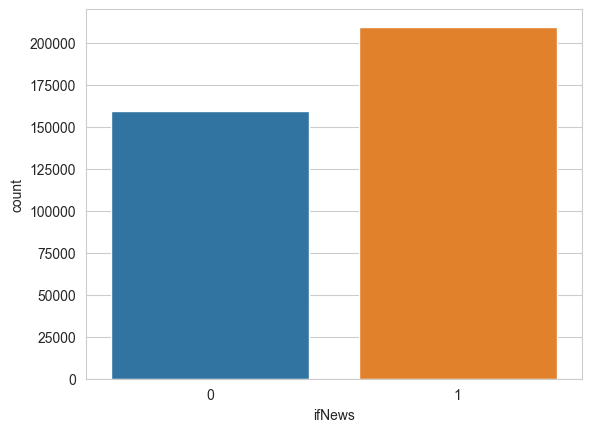

In [8]:
# visualizing the data
sns.set_style('whitegrid')
sns.countplot(x='ifNews', data=df)

In [9]:
df['ifNews'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%'

1    56.8%
0    43.2%
Name: ifNews, dtype: object

Acceptable difference in percentage of values among the two classes (ifNews: 1 and ifNews: 0)

In [11]:
for index,text in enumerate(df['text'][350:400]):
  print('Tweet %d:\n'%(index+1),text)

Tweet 1:
 I will revert Ebusiness vandalism in January 2014 and there's nothing you can do, Ebusiness retard.
Tweet 2:
 The 10 Best US Beaches Where You Can Drink (Legally)
Tweet 3:
 Ethnic conflict in Sri Lanka 
There was a dispute between Tamils and me regarding above topic. They wanted to insert few things and after consensus I inserted them to Major disputed areas of Ethnic conflict in Sri Lanka. But it seems like really stupid reasons resorting to militancy. Audience who don't know about consensus may feel I inserted these details with angry on Tamils and they will definetly suspect the neutrality of the rest of the article. Is there anyway I can link the claims in the article with ANI discussion (consensus).
Tweet 4:
 "
There are also notable people in reliable sources who claim that Palin didn't give birth to her own chldren. But it's a fringe theory and doesn't belong here.  hi! "
Tweet 5:
 Twitter's Unexpected Benefits
Tweet 6:
 "

That is not being ""ignorant"", it is knowing

In [94]:
#checking types
df['text'] = df['text'].astype(str)
for index, row in df.iterrows():
    if type(row['text']) != str:
        print('found non string datatype')
else:
    print('all strings')

all strings


Since there are no more features to consider, we can start with Cleaning the Text

In [122]:
#removing contractions
import re
contractions_dict = { "ain't": "are not","'s":" is","aren't": "are not",
                     "can't": "cannot","can't've": "cannot have",
                     "'cause": "because","could've": "could have","couldn't": "could not",
                     "couldn't've": "could not have", "didn't": "did not","doesn't": "does not",
                     "don't": "do not","hadn't": "had not","hadn't've": "had not have",
                     "hasn't": "has not","haven't": "have not","he'd": "he would",
                     "he'd've": "he would have","he'll": "he will", "he'll've": "he will have",
                     "how'd": "how did","how'd'y": "how do you","how'll": "how will",
                     "I'd": "I would", "I'd've": "I would have","I'll": "I will",
                     "I'll've": "I will have","I'm": "I am","I've": "I have", "isn't": "is not",
                     "it'd": "it would","it'd've": "it would have","it'll": "it will",
                     "it'll've": "it will have", "let's": "let us","ma'am": "madam",
                     "mayn't": "may not","might've": "might have","mightn't": "might not", 
                     "mightn't've": "might not have","must've": "must have","mustn't": "must not",
                     "mustn't've": "must not have", "needn't": "need not",
                     "needn't've": "need not have","o'clock": "of the clock","oughtn't": "ought not",
                     "oughtn't've": "ought not have","shan't": "shall not","sha'n't": "shall not",
                     "shan't've": "shall not have","she'd": "she would","she'd've": "she would have",
                     "she'll": "she will", "she'll've": "she will have","should've": "should have",
                     "shouldn't": "should not", "shouldn't've": "should not have","so've": "so have",
                     "that'd": "that would","that'd've": "that would have", "there'd": "there would",
                     "there'd've": "there would have", "they'd": "they would",
                     "they'd've": "they would have","they'll": "they will",
                     "they'll've": "they will have", "they're": "they are","they've": "they have",
                     "to've": "to have","wasn't": "was not","we'd": "we would",
                     "we'd've": "we would have","we'll": "we will","we'll've": "we will have",
                     "we're": "we are","we've": "we have", "weren't": "were not","what'll": "what will",
                     "what'll've": "what will have","what're": "what are", "what've": "what have",
                     "when've": "when have","where'd": "where did", "where've": "where have",
                     "who'll": "who will","who'll've": "who will have","who've": "who have",
                     "why've": "why have","will've": "will have","won't": "will not",
                     "won't've": "will not have", "would've": "would have","wouldn't": "would not",
                     "wouldn't've": "would not have","y'all": "you all", "y'all'd": "you all would",
                     "y'all'd've": "you all would have","y'all're": "you all are",
                     "y'all've": "you all have", "you'd": "you would","you'd've": "you would have",
                     "you'll": "you will","you'll've": "you will have", "you're": "you are",
                     "you've": "you have"}

#regex to find contractions
contractions_re=re.compile('(%s)' % '|'.join(contractions_dict.keys()))

#function to replace contractions
def expand_contractions(text, contractions_dict=contractions_dict):
    def replace(match):
        return contractions_dict[match.group(0)]
    return contractions_re.sub(replace, text)

In [123]:
#applying function to the dataframe
df['text']=df['text'].apply(lambda x:expand_contractions(x))

In [124]:
#lowercasing all text for normalization
df['cleaned']=df['text'].apply(lambda x: x.lower())
df

,text,ifNews,cleaned
0,"actually, i am correct and you are ill-informe...",0,"actually, i am correct and you are ill-informe..."
1,librier \r\n\r\nanon raised this issue in thei...,0,librier \r\n\r\nanon raised this issue in thei...
2,article deleted \r\n\r\nredirect history of ar...,0,article deleted \r\n\r\nredirect history of ar...
3,thx & sorry \r\nthe article is almost certainl...,0,thx & sorry \r\nthe article is almost certainl...
4,"(or, of course, you could try and recreate the...",0,"(or, of course, you could try and recreate the..."
...,...,...,...
369093,nicole richie relation \r\n\r\nis it true that...,0,nicole richie relation \r\n\r\nis it true that...
369094,"""\r\n\r\nreceiving money from kgb (edit reques...",0,"""\r\n\r\nreceiving money from kgb (edit reques..."
369095,"""\r\n\r\n psy rm \r\n\r\nwhy did you close the...",0,"""\r\n\r\n psy rm \r\n\r\nwhy did you close the..."
369096,how to use big data as a force for social good,1,how to use big data as a force for social good


In [36]:
df.drop('lowercase', axis=1)

,text,ifNews,cleaned
0,"actually, i am correct and you are ill-informe...",0,"actually, i am correct and you are ill-informe..."
1,librier \r\n\r\nanon raised this issue in thei...,0,librier \r\n\r\nanon raised this issue in thei...
2,article deleted \r\n\r\nredirect history of ar...,0,article deleted \r\n\r\nredirect history of ar...
3,thx & sorry \r\nthe article is almost certainl...,0,thx & sorry \r\nthe article is almost certainl...
4,"(or, of course, you could try and recreate the...",0,"(or, of course, you could try and recreate the..."
...,...,...,...
369093,nicole richie relation \r\n\r\nis it true that...,0,nicole richie relation \r\n\r\nis it true that...
369094,"""\r\n\r\nreceiving money from kgb (edit reques...",0,"""\r\n\r\nreceiving money from kgb (edit reques..."
369095,"""\r\n\r\n psy rm \r\n\r\nwhy did you close the...",0,"""\r\n\r\n psy rm \r\n\r\nwhy did you close the..."
369096,how to use big data as a force for social good,1,how to use big data as a force for social good


In [125]:
#now we will remove punctuations
import string
df['cleaned']=df['cleaned'].apply(lambda x: re.sub('[%s]' % re.escape(string.punctuation), '', x))


In [126]:
df['cleaned']

0         actually i am correct and you are illinformed ...
1         librier \r\n\r\nanon raised this issue in thei...
2         article deleted \r\n\r\nredirect history of ar...
3         thx  sorry \r\nthe article is almost certainly...
4         or of course you could try and recreate them f...
                                ...                        
369093    nicole richie relation \r\n\r\nis it true that...
369094    \r\n\r\nreceiving money from kgb edit request\...
369095    \r\n\r\n psy rm \r\n\r\nwhy did you close the ...
369096       how to use big data as a force for social good
369097    apparently you should not have to wait long be...
Name: cleaned, Length: 369092, dtype: object

In [127]:
# replacing all occurrences of escape sequences with blank characters
df['cleaned'] = df['cleaned'].replace({'\n': '', '\r': ''}, regex=True)

In [128]:
df

,text,ifNews,cleaned
0,"actually, i am correct and you are ill-informe...",0,actually i am correct and you are illinformed ...
1,librier \r\n\r\nanon raised this issue in thei...,0,librier anon raised this issue in their edit s...
2,article deleted \r\n\r\nredirect history of ar...,0,article deleted redirect history of aranorin t...
3,thx & sorry \r\nthe article is almost certainl...,0,thx sorry the article is almost certainly mad...
4,"(or, of course, you could try and recreate the...",0,or of course you could try and recreate them f...
...,...,...,...
369093,nicole richie relation \r\n\r\nis it true that...,0,nicole richie relation is it true that nicole ...
369094,"""\r\n\r\nreceiving money from kgb (edit reques...",0,receiving money from kgb edit requestrajiv gan...
369095,"""\r\n\r\n psy rm \r\n\r\nwhy did you close the...",0,psy rm why did you close the rm as no consens...
369096,how to use big data as a force for social good,1,how to use big data as a force for social good


In [62]:
df = df.drop('lowercase', axis=1)

In [63]:
df

,text,ifNews,cleaned
0,"actually, i am correct and you are ill-informe...",0,actually i am correct and you are illinformed ...
1,librier \r\n\r\nanon raised this issue in thei...,0,librier anon raised this issue in their edit s...
2,article deleted \r\n\r\nredirect history of ar...,0,article deleted redirect history of aranorin t...
3,thx & sorry \r\nthe article is almost certainl...,0,thx sorry the article is almost certainly mad...
4,"(or, of course, you could try and recreate the...",0,or of course you could try and recreate them f...
...,...,...,...
369093,nicole richie relation \r\n\r\nis it true that...,0,nicole richie relation is it true that nicole ...
369094,"""\r\n\r\nreceiving money from kgb (edit reques...",0,receiving money from kgb edit requestrajiv gan...
369095,"""\r\n\r\n psy rm \r\n\r\nwhy did you close the...",0,psy rm why did you close the rm as no consens...
369096,how to use big data as a force for social good,1,how to use big data as a force for social good


In [121]:
df = df.drop('cleaned', axis=1)

In [129]:
#removing digits and words containing digits
df['cleaned']=df['cleaned'].apply(lambda x: re.sub('\w*\d\w*','', x))

In [130]:
#removing extra spaces
df['cleaned']=df['cleaned'].apply(lambda x: re.sub(' +',' ',x))

In [131]:
# let us look at our cleaned data now:
for index,text in enumerate(df['cleaned'][350:400]):
  print('Tweet %d:\n'%(index+1),text)

Tweet 1:
 i will revert ebusiness vandalism in january and there is nothing you can do ebusiness retard
Tweet 2:
 the best us beaches where you can drink legally
Tweet 3:
 ethnic conflict in sri lanka there was a dispute between tamils and me regarding above topic they wanted to insert few things and after consensus i inserted them to major disputed areas of ethnic conflict in sri lanka but it seems like really stupid reasons resorting to militancy audience who do not know about consensus may feel i inserted these details with angry on tamils and they will definetly suspect the neutrality of the rest of the article is there anyway i can link the claims in the article with ani discussion consensus
Tweet 4:
 there are also notable people in reliable sources who claim that palin did not give birth to her own chldren but it is a fringe theory and does not belong here hi 
Tweet 5:
 twitter is unexpected benefits
Tweet 6:
 that is not being ignorant it is knowing enough about music as an art

Preparing Data for EDA

In [105]:
#removing stopwords
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\stopwords.zip.


In [132]:
stop_words = stopwords.words('english')
df['cleaned'] = df['cleaned'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop_words)]))

In [108]:
#lemmatization
nltk.download('wordnet')
from nltk.stem import WordNetLemmatizer
lemmatizer = WordNetLemmatizer()


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...


In [111]:
def lemmatize_words(text):
    words = text.split()
    words = [lemmatizer.lemmatize(word, pos='v') for word in words]
    return ' '.join(words)

In [133]:
df['cleaned'] = df['cleaned'].apply(lemmatize_words)

In [134]:
df

,text,ifNews,cleaned
0,"actually, i am correct and you are ill-informe...",0,actually correct illinformed like remove post ...
1,librier \r\n\r\nanon raised this issue in thei...,0,librier anon raise issue edit summary agree te...
2,article deleted \r\n\r\nredirect history of ar...,0,article delete redirect history aranorin towns...
3,thx & sorry \r\nthe article is almost certainl...,0,thx sorry article almost certainly make assume...
4,"(or, of course, you could try and recreate the...",0,course could try recreate scratch good source ...
...,...,...,...
369093,nicole richie relation \r\n\r\nis it true that...,0,nicole richie relation true nicole richie chri...
369094,"""\r\n\r\nreceiving money from kgb (edit reques...",0,receive money kgb edit requestrajiv gandhi fam...
369095,"""\r\n\r\n psy rm \r\n\r\nwhy did you close the...",0,psy rm close rm consensus decision current tit...
369096,how to use big data as a force for social good,1,use big data force social good


In [137]:
df = df.iloc[:,[0,2,1]]

Exploratory Data Analysis

In [139]:
# wordcloud
from wordcloud import WordCloud, STOPWORDS

In [147]:
stopwords = set(STOPWORDS)
comment_words = ''
for line in df['cleaned']:
    val = str(line)
    print('loaded line')
    # split the value
    tokens = val.split()
    print('split value: ')
    comment_words += " ".join(tokens)+" "
    print('joined tokens')

joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 
joined tokens
loaded line
split value: 


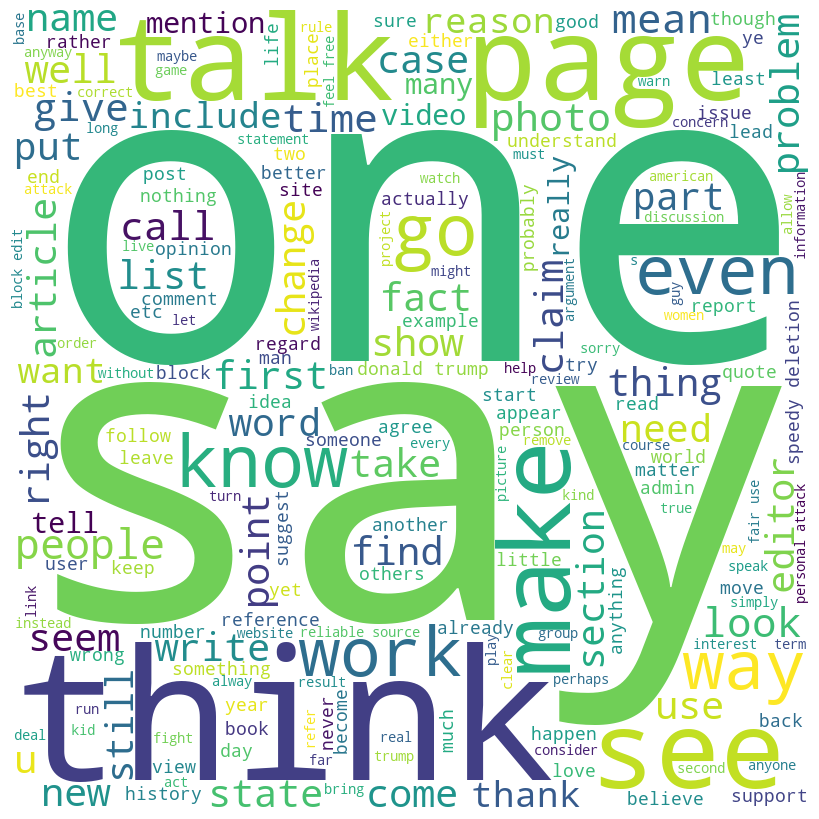

In [148]:
WC = WordCloud(width = 800, height = 800, background_color = 'white', stopwords = stopwords, min_font_size =10).generate(comment_words)
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(WC)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.show()

In [143]:
df.reset_index(inplace=True, drop=True)

In [144]:
df

,text,cleaned,ifNews
0,"actually, i am correct and you are ill-informe...",actually correct illinformed like remove post ...,0
1,librier \r\n\r\nanon raised this issue in thei...,librier anon raise issue edit summary agree te...,0
2,article deleted \r\n\r\nredirect history of ar...,article delete redirect history aranorin towns...,0
3,thx & sorry \r\nthe article is almost certainl...,thx sorry article almost certainly make assume...,0
4,"(or, of course, you could try and recreate the...",course could try recreate scratch good source ...,0
...,...,...,...
369087,nicole richie relation \r\n\r\nis it true that...,nicole richie relation true nicole richie chri...,0
369088,"""\r\n\r\nreceiving money from kgb (edit reques...",receive money kgb edit requestrajiv gandhi fam...,0
369089,"""\r\n\r\n psy rm \r\n\r\nwhy did you close the...",psy rm close rm consensus decision current tit...,0
369090,how to use big data as a force for social good,use big data force social good,1


In [145]:
df = df.drop('text', axis=1)
df

,cleaned,ifNews
0,actually correct illinformed like remove post ...,0
1,librier anon raise issue edit summary agree te...,0
2,article delete redirect history aranorin towns...,0
3,thx sorry article almost certainly make assume...,0
4,course could try recreate scratch good source ...,0
...,...,...
369087,nicole richie relation true nicole richie chri...,0
369088,receive money kgb edit requestrajiv gandhi fam...,0
369089,psy rm close rm consensus decision current tit...,0
369090,use big data force social good,1


In [146]:
df.to_csv('datasets/news_or_not_cleaned.csv')